In [ ]:
# This is the Exploratory data analysis of the various causes of deaths in the world from 1990 t0 2019.

In [1]:
#Importing relevant libraries
import pandas as pd 
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import re
%matplotlib inline

In [2]:
#To show all hidden columns
pd.set_option('display.max_columns', None)

In [3]:
#Loading the dataset
df = pd.read_csv('Global_causes_of_deaths.csv')

In [4]:
#Showing the first two columns
df.head(2)

,Entity,Code,Year,Number of executions (Amnesty International),Deaths - Meningitis - Sex: Both - Age: All Ages (Number),Deaths - Neoplasms - Sex: Both - Age: All Ages (Number),"Deaths - Fire, heat, and hot substances - Sex: Both - Age: All Ages (Number)",Deaths - Malaria - Sex: Both - Age: All Ages (Number),Deaths - Drowning - Sex: Both - Age: All Ages (Number),Deaths - Interpersonal violence - Sex: Both - Age: All Ages (Number),Deaths - HIV/AIDS - Sex: Both - Age: All Ages (Number),Deaths - Drug use disorders - Sex: Both - Age: All Ages (Number),Deaths - Tuberculosis - Sex: Both - Age: All Ages (Number),Deaths - Road injuries - Sex: Both - Age: All Ages (Number),Deaths - Maternal disorders - Sex: Both - Age: All Ages (Number),Deaths - Lower respiratory infections - Sex: Both - Age: All Ages (Number),Deaths - Neonatal disorders - Sex: Both - Age: All Ages (Number),Deaths - Alcohol use disorders - Sex: Both - Age: All Ages (Number),Deaths - Exposure to forces of nature - Sex: Both - Age: All Ages (Number),Deaths - Diarrheal diseases - Sex: Both - Age: All Ages (Number),Deaths - Environmental heat and cold exposure - Sex: Both - Age: All Ages (Number),Deaths - Nutritional deficiencies - Sex: Both - Age: All Ages (Number),Deaths - Self-harm - Sex: Both - Age: All Ages (Number),Deaths - Conflict and terrorism - Sex: Both - Age: All Ages (Number),Deaths - Diabetes mellitus - Sex: Both - Age: All Ages (Number),Deaths - Poisonings - Sex: Both - Age: All Ages (Number),Deaths - Protein-energy malnutrition - Sex: Both - Age: All Ages (Number),Terrorism (deaths),Deaths - Cardiovascular diseases - Sex: Both - Age: All Ages (Number),Deaths - Chronic kidney disease - Sex: Both - Age: All Ages (Number),Deaths - Chronic respiratory diseases - Sex: Both - Age: All Ages (Number),Deaths - Cirrhosis and other chronic liver diseases - Sex: Both - Age: All Ages (Number),Deaths - Digestive diseases - Sex: Both - Age: All Ages (Number),Deaths - Acute hepatitis - Sex: Both - Age: All Ages (Number),Deaths - Alzheimer's disease and other dementias - Sex: Both - Age: All Ages (Number),Deaths - Parkinson's disease - Sex: Both - Age: All Ages (Number)
0,Afghanistan,AFG,2007,15,2933.0,15925.0,481.0,393.0,2127.0,3657.0,148.0,252.0,4995.0,7425.0,4990.0,27672.0,23890.0,111.0,296.0,9320.0,57.0,2488.0,1310.0,8220.0,3189.0,513.0,2439.0,1199.0,53962.0,4490.0,7222.0,3346.0,6458.0,3437.0,1402.0,450.0
1,Afghanistan,AFG,2008,17,2731.0,16148.0,462.0,255.0,1973.0,3785.0,157.0,261.0,4790.0,7355.0,5020.0,25800.0,23792.0,114.0,1317.0,8275.0,57.0,2277.0,1330.0,6895.0,3261.0,495.0,2231.0,1092.0,54051.0,4534.0,7143.0,3316.0,6408.0,3005.0,1424.0,455.0


In [5]:
#Renaming column headers
df.rename(columns = {'Entity': 'Country', 'Code': 'Country Code', 'Year': 'Year_of_Death',
                     'Number of executions (Amnesty International)':'Executions_Amty_Int', 
                     'Deaths - Meningitis - Sex: Both - Age: All Ages (Number)': 'Meningitis',
                     'Deaths - Neoplasms - Sex: Both - Age: All Ages (Number)': 'Neoplasms',
                     'Deaths - Fire, heat, and hot substances - Sex: Both - Age: All Ages (Number)': 'Fire_heat_and_hot_substances',
                     'Deaths - Malaria - Sex: Both - Age: All Ages (Number)': 'Malaria', 
                     'Deaths - Drowning - Sex: Both - Age: All Ages (Number)': 'Drowning', 
                     'Deaths - Interpersonal violence - Sex: Both - Age: All Ages (Number)': 'Interpersonal_violence', 
                     'Deaths - HIV/AIDS - Sex: Both - Age: All Ages (Number)': 'HIV/AIDS', 
                     'Deaths - Drug use disorders - Sex: Both - Age: All Ages (Number)': 'Drug_use_disorders',
                     'Deaths - Tuberculosis - Sex: Both - Age: All Ages (Number)': 'Tuberculosis', 
                     'Deaths - Road injuries - Sex: Both - Age: All Ages (Number)': 'Road_injuries',
                     'Deaths - Maternal disorders - Sex: Both - Age: All Ages (Number)': 'Maternal_disorders', 
                     'Deaths - Lower respiratory infections - Sex: Both - Age: All Ages (Number)': 'Lower_respiratory_infections',
                     'Deaths - Neonatal disorders - Sex: Both - Age: All Ages (Number)': 'Neonatal_disorders', 
                     'Deaths - Alcohol use disorders - Sex: Both - Age: All Ages (Number)': 'Alcohol_use_disorders', 
                     'Deaths - Exposure to forces of nature - Sex: Both - Age: All Ages (Number': 'Exposure_to_forces_of_nature',
                     'Deaths - Diarrheal diseases - Sex: Both - Age: All Ages (Number)': 'Diarrheal_diseases', 
                     'Deaths - Environmental heat and cold exposure - Sex: Both - Age: All Ages (Number)': 'Environmental_heat_and_cold_exposure',
                     'Deaths - Nutritional deficiencies - Sex: Both - Age: All Ages (Number)': 'Nutritional_deficiencies',
                     'Deaths - Self-harm - Sex: Both - Age: All Ages (Number)': 'Self-harm',
                     'Deaths - Conflict and terrorism - Sex: Both - Age: All Ages (Number)': 'Conflict_and_terrorism', 
                     'Deaths - Diabetes mellitus - Sex: Both - Age: All Ages (Number': 'Diabetes_Mellitus',
                     'Deaths - Poisonings - Sex: Both - Age: All Ages (Number)': 'Poisonings', 
                     'Deaths - Protein-energy malnutrition - Sex: Both - Age: All Ages (Number)': 'Protein-energy_malnutrition',
                     'Terrorism (deaths)': 'Terrorism',
                     'Deaths - Cardiovascular diseases - Sex: Both - Age: All Ages (Number)': 'Cardiovascular_diseases', 
                     'Deaths - Chronic kidney disease - Sex: Both - Age: All Ages (Number)': 'Chronic_kidney_disease', 
                     'Deaths - Chronic respiratory diseases - Sex: Both - Age: All Ages (Number)': 'Deaths - Chronic_Respiratory_diseases',
                     'Deaths - Cirrhosis and other chronic liver diseases - Sex: Both - Age: All Ages (Number)': 'Cirrhosis_liver_diseases', 
                     'Deaths - Digestive diseases - Sex: Both - Age: All Ages (Number)': 'Digestive_diseases',
                     'Deaths - Acute hepatitis - Sex: Both - Age: All Ages (Number)': 'Acute_hepatitis', 
                     "Deaths - Alzheimer's disease and other dementias - Sex: Both - Age: All Ages (Number)": 'Alzheimer disease',
                     "Deaths - Parkinson's disease - Sex: Both - Age: All Ages (Number)": 'Parkinson disease'}, inplace = True)

In [6]:
df.rename(columns = {'Deaths - Exposure to forces of nature - Sex: Both - Age: All Ages (Number)': 'Exposure_to_forces_of_nature', 
                     'Deaths - Diabetes mellitus - Sex: Both - Age: All Ages (Number)': 'Diabetes_mellitus', 
                     'Deaths - Chronic_Respiratory_diseases': 'Chronic_Respiratory_diseases'}, inplace = True)

In [7]:
#Creating a copy of the dataframe
new_df = df[:]

In [8]:
#To display the first five rows of the dataframe
new_df.head()

,Country,Country Code,Year_of_Death,Executions_Amty_Int,Meningitis,Neoplasms,Fire_heat_and_hot_substances,Malaria,Drowning,Interpersonal_violence,HIV/AIDS,Drug_use_disorders,Tuberculosis,Road_injuries,Maternal_disorders,Lower_respiratory_infections,Neonatal_disorders,Alcohol_use_disorders,Exposure_to_forces_of_nature,Diarrheal_diseases,Environmental_heat_and_cold_exposure,Nutritional_deficiencies,Self-harm,Conflict_and_terrorism,Diabetes_mellitus,Poisonings,Protein-energy_malnutrition,Terrorism,Cardiovascular_diseases,Chronic_kidney_disease,Chronic_Respiratory_diseases,Cirrhosis_liver_diseases,Digestive_diseases,Acute_hepatitis,Alzheimer disease,Parkinson disease
0,Afghanistan,AFG,2007,15,2933.0,15925.0,481.0,393.0,2127.0,3657.0,148.0,252.0,4995.0,7425.0,4990.0,27672.0,23890.0,111.0,296.0,9320.0,57.0,2488.0,1310.0,8220.0,3189.0,513.0,2439.0,1199.0,53962.0,4490.0,7222.0,3346.0,6458.0,3437.0,1402.0,450.0
1,Afghanistan,AFG,2008,17,2731.0,16148.0,462.0,255.0,1973.0,3785.0,157.0,261.0,4790.0,7355.0,5020.0,25800.0,23792.0,114.0,1317.0,8275.0,57.0,2277.0,1330.0,6895.0,3261.0,495.0,2231.0,1092.0,54051.0,4534.0,7143.0,3316.0,6408.0,3005.0,1424.0,455.0
2,Afghanistan,AFG,2009,0,2460.0,16383.0,448.0,239.0,1852.0,3874.0,167.0,270.0,4579.0,7290.0,5013.0,24340.0,23672.0,115.0,101.0,7359.0,57.0,2040.0,1342.0,7617.0,3336.0,483.0,1998.0,1065.0,53964.0,4597.0,7045.0,3291.0,6358.0,2663.0,1449.0,460.0
3,Afghanistan,AFG,2011,2,2327.0,17094.0,448.0,390.0,1775.0,4170.0,184.0,292.0,4259.0,7432.0,4857.0,22883.0,23951.0,120.0,83.0,6412.0,58.0,1846.0,1391.0,9142.0,3550.0,483.0,1805.0,1525.0,54347.0,4785.0,6916.0,3318.0,6370.0,2365.0,1508.0,473.0
4,Afghanistan,AFG,2012,14,2254.0,17522.0,445.0,94.0,1716.0,4245.0,191.0,305.0,4122.0,7494.0,4736.0,22162.0,24057.0,123.0,333.0,6008.0,103.0,1705.0,1413.0,11350.0,3682.0,482.0,1667.0,3521.0,54868.0,4846.0,6878.0,3353.0,6398.0,2264.0,1544.0,482.0


In [9]:
#To show the metadata of the dataframe
new_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8254 entries, 0 to 8253
Data columns (total 36 columns):
 #   Column                                Non-Null Count  Dtype  
---  ------                                --------------  -----  
 0   Country                               8254 non-null   object 
 1   Country Code                          6206 non-null   object 
 2   Year_of_Death                         8254 non-null   int64  
 3   Executions_Amty_Int                   267 non-null    object 
 4   Meningitis                            8010 non-null   float64
 5   Neoplasms                             8010 non-null   float64
 6   Fire_heat_and_hot_substances          8010 non-null   float64
 7   Malaria                               8010 non-null   float64
 8   Drowning                              8010 non-null   float64
 9   Interpersonal_violence                8010 non-null   float64
 10  HIV/AIDS                              8010 non-null   float64
 11  Drug_use_disorder

In [10]:
#A transposed statistical display of the dataset
new_df.describe().T

,count,mean,std,min,25%,50%,75%,max
Year_of_Death,8254.0,2004.448025,8.642230e+00,1990.0,1997.00,2004.0,2012.00,2019.0
Meningitis,8010.0,12909.701124,4.179939e+04,0.0,29.00,294.0,3187.75,432524.0
Neoplasms,8010.0,298398.509363,8.643901e+05,1.0,1934.25,10338.5,91869.25,10079637.0
Fire_heat_and_hot_substances,8010.0,4444.838077,1.211191e+04,0.0,35.00,244.0,1470.75,129705.0
Malaria,8010.0,31812.044569,1.230359e+05,0.0,0.00,1.0,2462.00,961129.0
Drowning,8010.0,12532.637953,4.009599e+04,0.0,58.00,393.5,3017.75,460665.0
Interpersonal_violence,8010.0,15315.848315,4.288854e+04,0.0,76.25,494.0,4372.50,463129.0
HIV/AIDS,8010.0,47251.428215,1.744798e+05,0.0,26.00,420.0,9484.50,1844490.0
Drug_use_disorders,8010.0,3469.958926,1.118651e+04,0.0,7.00,57.0,518.75,128083.0
Tuberculosis,8010.0,56055.270162,1.837876e+05,0.0,62.00,956.0,10377.75,1808478.0


In [11]:
new_df.shape

(8254, 36)

In [12]:
#To display all columns with null values
new_df.isnull().sum()

Country                                    0
Country Code                            2048
Year_of_Death                              0
Executions_Amty_Int                     7987
Meningitis                               244
Neoplasms                                244
Fire_heat_and_hot_substances             244
Malaria                                  244
Drowning                                 244
Interpersonal_violence                   244
HIV/AIDS                                 244
Drug_use_disorders                       244
Tuberculosis                             244
Road_injuries                            244
Maternal_disorders                       244
Lower_respiratory_infections             244
Neonatal_disorders                       244
Alcohol_use_disorders                    244
Exposure_to_forces_of_nature             244
Diarrheal_diseases                       244
Environmental_heat_and_cold_exposure     244
Nutritional_deficiencies                 244
Self-harm 

In [13]:
# To dispaly all integer columns
new_df_int = []
for x in new_df.dtypes.index:
    if new_df.dtypes[x] == 'int64':
        new_df_int.append(x)
        
new_df_int

['Year_of_Death']

In [14]:
# To dispaly all float64 columns
new_df_int = []
for x in new_df.dtypes.index:
    if new_df.dtypes[x] == 'float':
        new_df_int.append(x)
        
new_df_int

['Meningitis',
 'Neoplasms',
 'Fire_heat_and_hot_substances',
 'Malaria',
 'Drowning',
 'Interpersonal_violence',
 'HIV/AIDS',
 'Drug_use_disorders',
 'Tuberculosis',
 'Road_injuries',
 'Maternal_disorders',
 'Lower_respiratory_infections',
 'Neonatal_disorders',
 'Alcohol_use_disorders',
 'Exposure_to_forces_of_nature',
 'Diarrheal_diseases',
 'Environmental_heat_and_cold_exposure',
 'Nutritional_deficiencies',
 'Self-harm',
 'Conflict_and_terrorism',
 'Diabetes_mellitus',
 'Poisonings',
 'Protein-energy_malnutrition',
 'Terrorism',
 'Cardiovascular_diseases',
 'Chronic_kidney_disease',
 'Chronic_Respiratory_diseases',
 'Cirrhosis_liver_diseases',
 'Digestive_diseases',
 'Acute_hepatitis',
 'Alzheimer disease',
 'Parkinson disease']

In [15]:
# To dispaly all object columns
new_df_int = []
for x in new_df.dtypes.index:
    if new_df.dtypes[x] == 'object':
        new_df_int.append(x)
        
new_df_int

['Country', 'Country Code', 'Executions_Amty_Int']

In [16]:
#Dropping two columns
new_df.drop(columns = ['Executions_Amty_Int', 'Country Code'], inplace = True)

C:\swsetup\New folder\lib\site-packages\pandas\core\frame.py:4906: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return super().drop(


In [17]:
#Replacing a null values with the mean of the dataframe
new_df.fillna(new_df.mean(),inplace = True)

C:\Users\user\AppData\Local\Temp/ipykernel_15160/4272155509.py:2: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  new_df.fillna(new_df.mean(),inplace = True)
C:\swsetup\New folder\lib\site-packages\pandas\core\generic.py:6392: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return self._update_inplace(result)


In [18]:
#To verify there are no other null values in the dataframe
new_df.isna().sum()

Country                                 0
Year_of_Death                           0
Meningitis                              0
Neoplasms                               0
Fire_heat_and_hot_substances            0
Malaria                                 0
Drowning                                0
Interpersonal_violence                  0
HIV/AIDS                                0
Drug_use_disorders                      0
Tuberculosis                            0
Road_injuries                           0
Maternal_disorders                      0
Lower_respiratory_infections            0
Neonatal_disorders                      0
Alcohol_use_disorders                   0
Exposure_to_forces_of_nature            0
Diarrheal_diseases                      0
Environmental_heat_and_cold_exposure    0
Nutritional_deficiencies                0
Self-harm                               0
Conflict_and_terrorism                  0
Diabetes_mellitus                       0
Poisonings                        

In [19]:
new_df.pivot_table(index = 'Year_of_Death', values = ['Meningitis', 'Neoplasms',
                                                      'Fire_heat_and_hot_substances', 'Malaria', 'Drowning', 'Interpersonal_violence', 'HIV/AIDS', 'Drug_use_disorders',
       'Tuberculosis', 'Road_injuries', 'Maternal_disorders',
       'Lower_respiratory_infections', 'Neonatal_disorders',
       'Alcohol_use_disorders', 'Exposure_to_forces_of_nature',
       'Diarrheal_diseases', 'Environmental_heat_and_cold_exposure',
       'Nutritional_deficiencies', 'Self-harm', 'Conflict_and_terrorism',
       'Diabetes_mellitus', 'Poisonings', 'Protein-energy_malnutrition',
       'Terrorism', 'Cardiovascular_diseases', 'Chronic_kidney_disease',
       'Chronic_Respiratory_diseases', 'Cirrhosis_liver_diseases',
       'Digestive_diseases', 'Acute_hepatitis', 'Alzheimer disease',
       'Parkinson disease'], aggfunc = 'sum')

,Acute_hepatitis,Alcohol_use_disorders,Alzheimer disease,Cardiovascular_diseases,Chronic_Respiratory_diseases,Chronic_kidney_disease,Cirrhosis_liver_diseases,Conflict_and_terrorism,Diabetes_mellitus,Diarrheal_diseases,Digestive_diseases,Drowning,Drug_use_disorders,Environmental_heat_and_cold_exposure,Exposure_to_forces_of_nature,Fire_heat_and_hot_substances,HIV/AIDS,Interpersonal_violence,Lower_respiratory_infections,Malaria,Maternal_disorders,Meningitis,Neonatal_disorders,Neoplasms,Nutritional_deficiencies,Parkinson disease,Poisonings,Protein-energy_malnutrition,Road_injuries,Self-harm,Terrorism,Tuberculosis
Year_of_Death,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1990,1.661965e+06,1.249543e+06,6.393869e+06,1.308505e+08,3.258818e+07,6.421137e+06,1.067155e+07,1.110766e+06,7.158245e+06,2.925154e+07,1.964008e+07,4.621206e+06,6.145225e+05,576158.615231,4.372296e+05,1.265927e+06,4.007790e+06,3.796059e+06,3.393282e+07,8.758178e+06,3.023030e+06,4.370912e+06,2.994935e+07,6.368086e+07,7.482045e+06,1.651046e+06,898864.222222,6.471534e+06,1.151764e+07,7.875844e+06,84655.698720,1.797335e+07
1991,1.657380e+06,1.316474e+06,6.673846e+06,1.328985e+08,3.327618e+07,6.581273e+06,1.086276e+07,8.387149e+05,7.382670e+06,2.943951e+07,1.995623e+07,4.575059e+06,6.770935e+05,593810.671161,1.436020e+06,1.278711e+06,5.023239e+06,3.912932e+06,3.371600e+07,8.979938e+06,2.993140e+06,4.350372e+06,2.976181e+07,6.515604e+07,7.237208e+06,1.698855e+06,900314.333333,6.249857e+06,1.159941e+07,8.042053e+06,76624.677966,1.813422e+07
1992,1.646589e+06,1.414127e+06,6.955305e+06,1.354871e+08,3.399616e+07,6.778986e+06,1.106688e+07,6.285105e+05,7.643306e+06,2.921887e+07,2.029752e+07,4.514849e+06,7.311735e+05,628736.727091,1.362854e+05,1.292700e+06,6.185702e+06,4.153043e+06,3.360680e+07,9.003701e+06,3.010785e+06,4.341994e+06,2.961701e+07,6.674348e+07,6.978514e+06,1.748998e+06,909005.444444,6.022944e+06,1.171822e+07,8.245211e+06,73229.723971,1.840361e+07
1993,1.569312e+06,1.456631e+06,6.697687e+06,1.316369e+08,3.287207e+07,6.477967e+06,1.070366e+07,5.721000e+05,7.384169e+06,2.743239e+07,1.957938e+07,4.335471e+06,7.349480e+05,668640.000000,2.031900e+05,1.259350e+06,6.841321e+06,4.199189e+06,3.197443e+07,8.656775e+06,2.830872e+06,4.118829e+06,2.816487e+07,6.459464e+07,6.507485e+06,1.682132e+06,882970.000000,5.622720e+06,1.124102e+07,8.064378e+06,93245.986510,1.733862e+07
1994,1.591217e+06,1.617405e+06,7.330315e+06,1.393954e+08,3.448724e+07,7.019021e+06,1.138206e+07,6.143654e+06,8.005891e+06,2.768482e+07,2.068427e+07,4.439960e+06,8.222436e+05,745401.559301,1.379752e+05,1.325004e+06,8.701827e+06,4.443971e+06,3.265090e+07,8.916309e+06,2.919340e+06,4.178250e+06,2.882937e+07,6.887554e+07,6.437942e+06,1.817816e+06,923220.111111,5.576330e+06,1.183842e+07,8.618473e+06,67772.195780,1.769225e+07
1995,1.574135e+06,1.651731e+06,7.610644e+06,1.409082e+08,3.478288e+07,7.239235e+06,1.157666e+07,6.763032e+05,8.263913e+06,2.711182e+07,2.093490e+07,4.391703e+06,8.594585e+05,750927.615231,2.084336e+05,1.317046e+06,1.016770e+07,4.470921e+06,3.241442e+07,9.021580e+06,2.901961e+06,4.151242e+06,2.870609e+07,7.026983e+07,7.098007e+06,1.874415e+06,920443.222222,6.271585e+06,1.196564e+07,8.726806e+06,67202.026634,1.760259e+07
1996,1.537720e+06,1.648099e+06,7.840580e+06,1.416507e+08,3.508088e+07,7.448282e+06,1.168176e+07,8.476532e+05,8.518086e+06,2.656425e+07,2.104785e+07,4.252830e+06,8.779755e+05,700090.615231,1.623596e+05,1.299951e+06,1.142593e+07,4.349887e+06,3.187989e+07,9.126420e+06,2.875882e+06,4.236686e+06,2.840057e+07,7.115734e+07,6.619371e+06,1.925851e+06,905442.222222,5.830991e+06,1.195681e+07,8.664227e+06,70489.498443,1.743498e+07
1997,1.519494e+06,1.633219e+06,8.017137e+06,1.422615e+08,3.535266e+07,7.679628e+06,1.177324e+07,9.533525e+05,8.770191e+06,2.614563e+07,2.116454e+07,4.145914e+06,8.851156e+05,660825.559301,1.814962e+05,1.289603e+06,1.253207e+07,4.282593e+06,3.137905e+07,9.305505e+06,2.886995e+06,4.054495e+06,2.809002e+07,7.184094e+07,6.368869e+06,1.973769e+06,887887.111111,5.610298e+06,1.198

In [20]:
new_df.groupby(['Year_of_Death']).sum()['Meningitis'].sort_values(ascending = False)

Year_of_Death
1990    4.370912e+06
1991    4.350372e+06
1992    4.341994e+06
1996    4.236686e+06
1994    4.178250e+06
1995    4.151242e+06
1993    4.118829e+06
1997    4.054495e+06
1998    3.957349e+06
1999    3.925535e+06
2000    3.914298e+06
2001    3.842552e+06
2002    3.769457e+06
2003    3.738645e+06
2005    3.683544e+06
2004    3.659508e+06
2006    3.636044e+06
2007    3.602614e+06
2008    3.512374e+06
2009    3.426390e+06
2010    3.324390e+06
2011    3.186528e+06
2012    3.052961e+06
2013    2.960438e+06
2014    2.873670e+06
2015    2.747332e+06
2016    2.671863e+06
2017    2.548515e+06
2018    2.387470e+06
2019    2.332419e+06
Name: Meningitis, dtype: float64

In [21]:
pd.options.display.float_format = '{:.4f}'.format

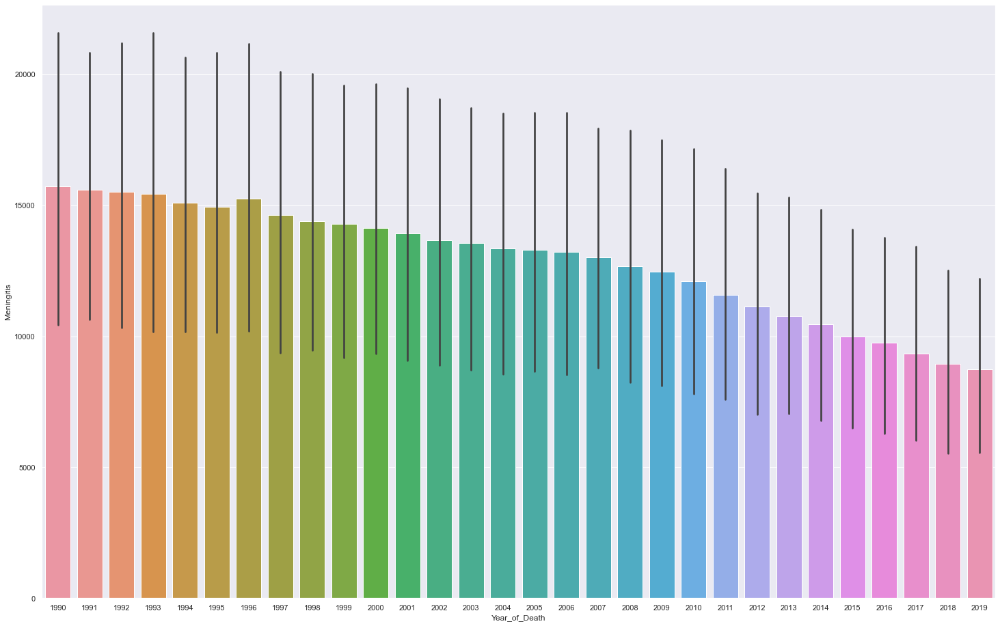

In [24]:
sns.barplot(data = new_df, x = 'Year_of_Death', y = 'Meningitis')
sns.set(rc = {'figure.figsize':(25,16)})

In [25]:
import plotly.express as px

In [26]:
fig = px.bar(new_df, x = 'Year_of_Death', y = 'Meningitis', color_discrete_sequence = ['Gold', 'Silver', 'Brown'])
fig.show()

In [27]:
fig = px.bar(new_df, x = 'Year_of_Death', y = 'Meningitis', color = 'Meningitis')
fig.show()

In [28]:
#To confirm the corrctness of the plot
new_df[new_df['Year_of_Death'] == 2019]['Meningitis'].sum()

2332419.0

In [29]:
new_df.groupby(['Year_of_Death']).sum()['Neoplasms'].sort_values(ascending = False)

Year_of_Death
2019   104021332.0000
2018   101156797.0000
2017   100274878.0562
2016    98641069.5655
2015    96923257.0749
2014    94770121.0749
2013    93144920.0749
2012    91393340.5655
2011    90238742.0749
2010    88829022.0749
2009    87226316.0749
2008    86414311.0936
2007    84629606.0936
2006    82723654.0749
2005    82617330.0936
2004    80217695.5655
2003    79674216.5843
2002    78314470.5843
2001    76898160.5843
2000    76067762.0936
1999    74030326.0749
1998    72455300.0749
1997    71840940.0936
1996    71157339.6030
1995    70269834.6030
1994    68875535.0936
1992    66743476.6217
1991    65156037.1124
1993    64594642.0000
1990    63680862.6030
Name: Neoplasms, dtype: float64

In [30]:
fig = px.bar(new_df, x = 'Year_of_Death', y = 'Neoplasms', color = 'Neoplasms')
fig.show()

In [31]:
new_df.groupby(['Year_of_Death']).sum()['Fire_heat_and_hot_substances'].sort_values(ascending = False)

Year_of_Death
1994   1325004.3808
1995   1317046.2189
1996   1299951.2189
2000   1293796.3808
1992   1292699.8950
1997   1289603.3808
2001   1287403.5427
2003   1282699.5427
2002   1278813.5427
1991   1278711.0569
1999   1277763.7046
2005   1271783.3808
1998   1266443.7046
1990   1265927.2189
1993   1259350.0000
2004   1252562.8665
2006   1235508.7046
2007   1228440.3808
2008   1214602.3808
2009   1185313.7046
2010   1176411.7046
2011   1160211.7046
2013   1141499.7046
2012   1138844.8665
2015   1125021.7046
2014   1124476.7046
2016   1117216.8665
2017   1106364.0285
2019   1099726.0000
2018   1094495.0000
Name: Fire_heat_and_hot_substances, dtype: float64

In [32]:
fig = px.bar(new_df, x = 'Year_of_Death', y = 'Fire_heat_and_hot_substances', color = 'Fire_heat_and_hot_substances')
fig.show()

In [33]:
new_df.groupby(['Year_of_Death']).sum()['Malaria'].sort_values(ascending = False)


Year_of_Death
2003   9942037.4011
2004   9877015.3120
2007   9772339.4457
2005   9767443.4457
2006   9720416.3566
2008   9718697.4457
2002   9654239.4011
2009   9503830.3566
2001   9493590.4011
2010   9401187.3566
1998   9326665.3566
1997   9305505.4457
1999   9261324.3566
2000   9206590.4457
1996   9126420.4903
1995   9021580.4903
1992   9003700.5794
2011   8980200.3566
1991   8979937.5348
1994   8916309.4457
1990   8758178.4903
1993   8656775.0000
2012   8304909.3120
2013   7795629.3566
2014   7532065.3566
2015   7315673.3566
2016   6860928.3120
2017   6524143.2674
2019   6481284.0000
2018   6367998.0000
Name: Malaria, dtype: float64

In [35]:
fig = px.bar(new_df, x = 'Year_of_Death', y = 'Malaria', color = 'Malaria')
fig.show()

In [198]:
new_df.groupby(['Year_of_Death']).sum()['Drowning'].sort_values(ascending = False)


Year_of_Death
1990   4621206.0175
1991   4575058.6554
1992   4514849.2934
1994   4439960.3795
1995   4391703.0175
1993   4335471.0000
1996   4252830.0175
1997   4145914.3795
1998   4062067.1036
1999   3965088.1036
2000   3897650.3795
2001   3771792.7416
2002   3636231.7416
2003   3498295.7416
2004   3383649.4657
2005   3367305.3795
2006   3218064.1036
2007   3165186.3795
2008   3097459.3795
2009   2995919.1036
2010   2939151.1036
2011   2845752.1036
2012   2780783.4657
2013   2707591.1036
2014   2626487.1036
2015   2584297.1036
2016   2518982.4657
2017   2438214.8277
2018   2348988.0000
2019   2318444.0000
Name: Drowning, dtype: float64

In [36]:
fig = px.bar(new_df, x = 'Year_of_Death', y = 'Drowning', color = 'Drowning')
fig.show()

In [38]:
new_df.groupby(['Year_of_Death']).sum()['Interpersonal_violence'].sort_values(ascending = False)

Year_of_Death
2002   4573951.6348
2000   4492312.4831
2001   4481227.6348
1995   4470921.3315
1994   4443971.4831
2003   4441959.6348
1999   4375272.7865
2004   4359169.9382
2005   4358761.4831
1996   4349887.3315
1998   4292972.7865
1997   4282593.4831
2006   4239391.7865
2008   4212860.4831
1993   4199189.0000
2007   4192174.4831
2009   4169609.7865
1992   4153043.0281
2010   4119326.7865
2012   4088395.9382
2015   4088259.7865
2011   4083632.7865
2013   4081943.7865
2017   4077815.0899
2014   4061760.7865
2016   4046697.9382
2018   4008793.0000
2019   3962124.0000
1991   3912932.1798
1990   3796059.3315
Name: Interpersonal_violence, dtype: float64

In [37]:
fig = px.bar(new_df, x = 'Year_of_Death', y = 'Interpersonal_violence', color = 'Interpersonal_violence')
fig.show()

In [202]:
new_df.groupby(['Year_of_Death']).sum()['HIV/AIDS'].sort_values(ascending = False)

Year_of_Death
2005   19640789.2821
2004   19580286.9975
2003   19276811.8539
2006   18901231.4257
2002   18584875.8539
2007   17973530.2821
2001   17666266.8539
2008   16821261.2821
2000   16605315.2821
2009   15609728.4257
1999   15234105.4257
2010   14675332.4257
2011   13816550.4257
1998   13795319.4257
2012   12855800.9975
1997   12532070.2821
2013   12119709.4257
2014   11551836.4257
1996   11425928.7104
2015   11112960.4257
2016   10741918.9975
2017   10198173.5693
1995   10167700.7104
2018    9337500.0000
2019    9028405.0000
1994    8701827.2821
1993    6841321.0000
1992    6185701.5668
1991    5023239.1386
1990    4007789.7104
Name: HIV/AIDS, dtype: float64

In [40]:
fig = px.bar(new_df, x = 'Year_of_Death', y = 'HIV/AIDS', color = 'HIV/AIDS')
fig.show()

In [204]:
new_df.groupby(['Year_of_Death']).sum()['Drug_use_disorders'].sort_values(ascending = False)

Year_of_Death
2019   1364993.0000
2018   1312393.0000
2017   1283178.7536
2016   1227277.7125
2015   1148309.6714
2014   1080418.6714
2013   1027974.6714
2012    984279.7125
2011    969041.6714
2000    962053.5893
2010    954358.6714
2008    948614.5893
2009    942653.6714
2001    936115.6303
2007    935998.5893
1999    930171.6714
2005    923184.5893
2006    922428.6714
2002    911939.6303
1998    905271.6714
2003    888749.6303
1997    885115.5893
2004    879102.7125
1996    877975.5482
1995    859458.5482
1994    822243.5893
1993    734948.0000
1992    731173.4660
1991    677093.5071
1990    614522.5482
Name: Drug_use_disorders, dtype: float64

In [41]:
fig = px.bar(new_df, x = 'Year_of_Death', y = 'Drug_use_disorders', color = 'Drug_use_disorders')
fig.show()

In [206]:
new_df.groupby(['Year_of_Death']).sum()['Tuberculosis'].sort_values(ascending = False)

Year_of_Death
1992   18403612.5121
1991   18134219.2419
1990   17973351.9718
1994   17692251.7016
1995   17602585.9718
1997   17447276.7016
1996   17434983.9718
2000   17363037.7016
1993   17338616.0000
1998   17330402.1613
1999   17288292.1613
2001   16994197.4315
2002   16676834.4315
2003   16315248.4315
2004   15675802.8911
2005   15590202.7016
2006   15153465.1613
2007   14975454.7016
2008   14751457.7016
2009   14224110.1613
2010   13825329.1613
2011   13495323.1613
2012   13309616.8911
2013   13265546.1613
2014   13142615.1613
2015   12872771.1613
2016   12638673.8911
2017   12405768.6210
2018   11805677.0000
2019   11553475.0000
Name: Tuberculosis, dtype: float64

In [42]:
fig = px.bar(new_df, x = 'Year_of_Death', y = 'Tuberculosis', color = 'Tuberculosis')
fig.show()

In [43]:
new_df.groupby(['Year_of_Death']).sum()['Road_injuries'].sort_values(ascending = False)

Year_of_Death
2008   13039470.1423
2007   12945963.1423
2005   12927251.1423
2009   12910214.9139
2010   12870145.9139
2006   12812690.9139
2011   12748924.9139
2004   12694464.2996
2003   12691054.5281
2002   12588155.5281
2012   12574828.2996
2001   12468542.5281
2000   12402977.1423
2013   12384180.9139
2014   12201365.9139
1999   12147429.9139
2015   12074548.9139
1997   11987848.1423
1998   11978722.9139
1995   11965636.7566
1996   11956809.7566
2016   11951278.2996
2017   11854728.6854
1994   11838415.1423
1992   11718224.9850
2019   11682433.0000
2018   11665769.0000
1991   11599405.3708
1990   11517636.7566
1993   11241016.0000
Name: Road_injuries, dtype: float64

In [44]:
fig = px.bar(new_df, x = 'Year_of_Death', y = 'Road_injuries', color = 'Road_injuries')
fig.show()

In [45]:
new_df.groupby(['Year_of_Death']).sum()['Maternal_disorders'].sort_values(ascending = False)

Year_of_Death
1990   3023030.0306
1992   3010784.7634
1991   2993140.3970
1994   2919339.6642
1995   2901961.0306
1997   2886994.6642
1996   2875882.0306
2000   2870677.6642
1998   2869753.9313
1999   2868103.9313
1993   2830872.0000
2001   2817243.2978
2002   2756833.2978
2003   2690640.2978
2005   2653197.6642
2004   2633311.5649
2006   2585375.9313
2007   2537652.6642
2008   2491210.6642
2009   2435245.9313
2010   2392537.9313
2011   2342250.9313
2012   2258980.5649
2013   2230906.9313
2014   2145690.9313
2015   2081779.9313
2016   2027219.5649
2017   1973958.1985
2018   1908483.0000
2019   1892483.0000
Name: Maternal_disorders, dtype: float64

In [46]:
fig = px.bar(new_df, x = 'Year_of_Death', y = 'Maternal_disorders', color = 'Maternal_disorders')
fig.show()

In [47]:
new_df.groupby(['Year_of_Death']).sum()['Lower_respiratory_infections'].sort_values(ascending = False)

Year_of_Death
1990   33932816.7965
1991   33715996.8689
1992   33606797.9413
1994   32650901.7241
1995   32414420.7965
1993   31974430.0000
1996   31879885.7965
1997   31379054.7241
1998   30723395.5793
1999   30260562.5793
2000   29925864.7241
2001   29157664.6517
2002   28756224.6517
2003   28345485.6517
2005   27771849.7241
2004   27642279.5069
2006   27257734.5793
2007   27188599.7241
2008   27048864.7241
2009   26524081.5793
2010   26276707.5793
2013   26242641.5793
2015   26235854.5793
2014   26204173.5793
2011   26115335.5793
2012   26017300.5069
2016   25971009.5069
2017   25591427.4345
2019   25041269.0000
2018   24974134.0000
Name: Lower_respiratory_infections, dtype: float64

In [49]:
fig = px.bar(new_df, x = 'Year_of_Death', y = 'Lower_respiratory_infections', color = 'Lower_respiratory_infections')
fig.show()

In [50]:
new_df.groupby(['Year_of_Death']).sum()['Neonatal_disorders'].sort_values(ascending = False)

Year_of_Death
1990   29949352.3528
1991   29761812.9303
1992   29617007.5079
1994   28829370.7753
1995   28706087.3528
1996   28400568.3528
1993   28164872.0000
1997   28090018.7753
1998   27687828.6202
1999   27436908.6202
2000   27369937.7753
2001   27001871.1978
2002   26827207.1978
2003   26636230.1978
2005   26254143.7753
2004   26231067.0427
2006   25748573.6202
2007   25576518.7753
2008   25257848.7753
2009   24681615.6202
2010   24238073.6202
2011   23806620.6202
2012   23301105.0427
2013   23008173.6202
2014   22413443.6202
2015   21898408.6202
2016   20994612.0427
2017   20083722.4652
2018   18833230.0000
2019   18245288.0000
Name: Neonatal_disorders, dtype: float64

In [51]:
fig = px.bar(new_df, x = 'Year_of_Death', y = 'Neonatal_disorders', color = 'Neonatal_disorders')
fig.show()

In [52]:
new_df.groupby(['Year_of_Death']).sum()[ 'Alcohol_use_disorders'].sort_values(ascending = False)

Year_of_Death
2005   1900320.6117
2004   1869142.1282
2003   1865017.4506
2006   1849987.2894
2002   1828438.4506
2007   1825957.6117
2008   1803677.6117
2001   1782497.4506
2009   1744117.2894
2000   1740664.6117
2010   1721060.2894
2019   1709565.0000
2016   1696197.1282
2017   1695005.9670
2011   1692581.2894
2015   1688641.2894
2018   1685875.0000
2014   1674131.2894
1999   1673449.2894
2013   1668957.2894
2012   1667714.1282
1995   1651730.7729
1996   1648098.7729
1997   1633218.6117
1998   1630028.2894
1994   1617404.6117
1993   1456631.0000
1992   1414127.0953
1991   1316473.9341
1990   1249542.7729
Name: Alcohol_use_disorders, dtype: float64

In [217]:
fig = px.bar(new_df, x = 'Year_of_Death', y =  'Alcohol_use_disorders', color =  'Alcohol_use_disorders')
fig.show()

In [218]:
new_df.groupby(['Year_of_Death']).sum()['Exposure_to_forces_of_nature'].sort_values(ascending = False)

Year_of_Death
2004   2445688.9285
2008   2228889.1835
2010   1987123.3468
1991   1436020.0202
2005    828567.1835
1999    642996.3468
1998    438573.3468
1990    437229.6019
2011    342918.3468
2003    311628.7652
2001    302833.7652
2013    265597.3468
1995    208433.6019
2006    204778.3468
1993    203190.0000
1997    181496.1835
2007    167128.1835
1996    162359.6019
2015    139888.3468
1994    137975.1835
1992    136285.4386
2017    129267.5101
2009    118694.3468
2018    109282.0000
2000    103354.1835
2002     98126.7652
2012     95662.9285
2016     94319.9285
2014     83803.3468
2019     59173.0000
Name: Exposure_to_forces_of_nature, dtype: float64

In [53]:
fig = px.bar(new_df, x = 'Year_of_Death', y = 'Exposure_to_forces_of_nature', color = 'Exposure_to_forces_of_nature')
fig.show()

In [220]:
new_df.groupby(['Year_of_Death']).sum()['Diarrheal_diseases']

Year_of_Death
1990   29251537.1969
1991   29439506.0330
1992   29218873.8690
1993   27432388.0000
1994   27684815.3608
1995   27111815.1969
1996   26564254.1969
1997   26145626.3608
1998   25658341.6886
1999   25205339.6886
2000   24827374.3608
2001   24156640.5247
2002   23520204.5247
2003   22845752.5247
2004   21943699.8526
2005   21794590.3608
2006   21491562.6886
2007   21342752.3608
2008   21030841.3608
2009   20202987.6886
2010   19737087.6886
2011   19469816.6886
2012   18727441.8526
2013   18348864.6886
2014   17729036.6886
2015   17266065.6886
2016   16795571.8526
2017   16636431.0165
2018   15616728.0000
2019   15181793.0000
Name: Diarrheal_diseases, dtype: float64

In [54]:
fig = px.bar(new_df, x = 'Year_of_Death', y = 'Diarrheal_diseases', color = 'Diarrheal_diseases')
fig.show()

In [55]:
new_df.groupby(['Year_of_Death']).sum()['Environmental_heat_and_cold_exposure'].sort_values(ascending = False)

Year_of_Death
1995   750927.6152
1994   745401.5593
2003   742497.5034
2002   719415.5034
2005   706402.5593
1996   700090.6152
2001   687579.5034
2004   687161.3915
2000   677036.5593
1993   668640.0000
1998   667525.4474
2006   665131.4474
1997   660825.5593
1999   652485.4474
1992   628736.7271
2007   620949.5593
2010   606374.4474
2008   600800.5593
1991   593810.6712
1990   576158.6152
2009   567654.4474
2011   535962.4474
2015   535081.4474
2012   531958.3915
2013   515092.4474
2014   506762.4474
2016   492241.3915
2019   479449.0000
2017   477866.3356
2018   464640.0000
Name: Environmental_heat_and_cold_exposure, dtype: float64

In [56]:
fig = px.bar(new_df, x = 'Year_of_Death', y = 'Environmental_heat_and_cold_exposure', color = 'Environmental_heat_and_cold_exposure')
fig.show()

In [57]:
new_df.groupby(['Year_of_Death']).sum()['Nutritional_deficiencies'].sort_values(ascending = False)

Year_of_Death
1990   7482044.6303
1991   7237207.6876
1995   7098006.6303
1992   6978513.7449
1996   6619370.6303
1993   6507485.0000
1994   6437941.5730
1997   6368868.5730
1998   6071071.4584
1999   5807843.4584
2000   5599694.5730
2001   5333006.5157
2002   5094431.5157
2003   4173176.5157
2004   3916311.4011
2005   3799403.5730
2006   3632662.4584
2007   3523016.5730
2008   3409643.5730
2009   3255591.4584
2010   3246251.4584
2011   3173359.4584
2012   3010665.4011
2013   2964201.4584
2014   2897287.4584
2015   2843148.4584
2016   2771400.4011
2017   2697389.3438
2018   2508095.0000
2019   2444227.0000
Name: Nutritional_deficiencies, dtype: float64

In [58]:
fig = px.bar(new_df, x = 'Year_of_Death', y = 'Nutritional_deficiencies', color = 'Nutritional_deficiencies')
fig.show()

In [59]:
new_df.groupby(['Year_of_Death']).sum()['Self-harm'].sort_values(ascending = False)

Year_of_Death
2000   8821783.2447
1999   8781565.1958
1995   8726805.7692
2005   8683788.2447
1998   8674909.1958
1996   8664226.7692
1997   8661926.2447
1994   8618473.2447
2001   8604733.7202
2003   8542524.7202
2004   8525594.6713
2002   8508446.7202
2006   8503527.1958
2007   8447368.2447
2008   8399150.2447
1992   8245210.8181
2009   8223743.1958
2010   8207513.1958
2011   8132530.1958
1993   8064378.0000
1991   8042053.2936
2012   7997491.6713
2013   7909681.1958
1990   7875843.7692
2014   7798169.1958
2015   7771952.1958
2016   7740495.6713
2017   7714167.1468
2019   7682558.0000
2018   7648006.0000
Name: Self-harm, dtype: float64

In [60]:
fig = px.bar(new_df, x = 'Year_of_Death', y = 'Self-harm', color = 'Self-harm')
fig.show()

In [61]:
new_df.groupby(['Year_of_Death']).sum()['Conflict_and_terrorism'].sort_values(ascending = False)

Year_of_Death
1994   6143653.5443
2014   1626829.2355
2015   1449403.2355
2016   1370595.5810
1999   1334037.2355
2000   1135915.5443
2017   1118331.9266
1990   1110766.1988
1998   1030349.2355
2013   1023420.2355
2012    963698.5810
1997    953352.5443
2018    876568.0000
1996    847653.1988
1991    838714.8532
2009    682413.2355
1995    676303.1988
2003    662922.8899
2006    657245.2355
2001    653464.8899
2004    645512.5810
2007    642089.5443
1992    628510.5076
2002    627076.8899
2008    613769.5443
2011    572363.2355
1993    572100.0000
2005    549036.5443
2019    529821.0000
2010    529285.2355
Name: Conflict_and_terrorism, dtype: float64

In [62]:
fig = px.bar(new_df, x = 'Year_of_Death', y = 'Conflict_and_terrorism', color = 'Conflict_and_terrorism')
fig.show()

In [65]:
new_df.groupby(['Year_of_Death']).sum()['Diabetes_mellitus'].sort_values(ascending = False)

Year_of_Death
2019   15409833.0000
2018   14939751.0000
2017   14717712.3670
2016   14348660.5949
2015   13936608.8227
2014   13488725.8227
2013   13072960.8227
2012   12641478.5949
2011   12305027.8227
2010   11993099.8227
2009   11772535.8227
2008   11662758.2784
2007   11376903.2784
2006   11088470.8227
2005   10974566.2784
2004   10534450.5949
2003   10448688.0506
2002   10153706.0506
2001    9798067.0506
2000    9550049.2784
1999    9208636.8227
1998    8957463.8227
1997    8770191.2784
1996    8518085.5062
1995    8263912.5062
1994    8005891.2784
1992    7643305.9619
1993    7384169.0000
1991    7382669.7341
1990    7158244.5062
Name: Diabetes_mellitus, dtype: float64

In [64]:
fig = px.bar(new_df, x = 'Year_of_Death', y = 'Diabetes_mellitus', color = 'Diabetes_mellitus')
fig.show()

In [232]:
new_df.groupby(['Year_of_Death']).sum()['Poisonings'].sort_values(ascending = False)

Year_of_Death
2005   936083.1111
1994   923220.1111
1995   920443.2222
2004   920138.7778
2003   918305.0000
2002   910720.0000
1992   909005.4444
2006   908342.8889
1996   905442.2222
2001   904217.0000
2008   903574.1111
2000   902435.1111
2007   901256.1111
1991   900314.3333
1990   898864.2222
2009   889897.8889
2010   887901.8889
1997   887887.1111
1993   882970.0000
1999   881250.8889
1998   874906.8889
2011   872625.8889
2012   854664.7778
2013   848172.8889
2014   832759.8889
2015   822652.8889
2016   809336.7778
2017   791345.6667
2018   765508.0000
2019   758680.0000
Name: Poisonings, dtype: float64

In [66]:
fig = px.bar(new_df, x = 'Year_of_Death', y = 'Poisonings', color = 'Poisonings')
fig.show()

In [67]:
new_df.groupby(['Year_of_Death']).sum()['Protein-energy_malnutrition'].sort_values(ascending = False)

Year_of_Death
1990   6471534.2297
1995   6271585.2297
1991   6249856.6142
1992   6022943.9988
1996   5830991.2297
1993   5622720.0000
1997   5610297.8452
1994   5576329.8452
1998   5359881.0762
1999   5145720.0762
2000   4967192.8452
2001   4733175.4607
2002   4532484.4607
2003   3651981.4607
2004   3430215.6916
2005   3321914.8452
2006   3165333.0762
2007   3060478.8452
2008   2951051.8452
2009   2814886.0762
2010   2810585.0762
2011   2739772.0762
2012   2581215.6916
2013   2538171.0762
2014   2475561.0762
2015   2426802.0762
2016   2361481.6916
2017   2292121.3071
2018   2120805.0000
2019   2062098.0000
Name: Protein-energy_malnutrition, dtype: float64

In [68]:
fig = px.bar(new_df, x = 'Year_of_Death', y = 'Protein-energy_malnutrition', color = 'Protein-energy_malnutrition')
fig.show()

In [69]:
new_df.groupby(['Year_of_Death']).sum()['Terrorism'].sort_values(ascending = False)

Year_of_Death
2014   190046.2165
2015   173484.4524
2016   158046.0934
2017   134514.2729
2013   125141.3961
2012   108305.7551
2007   103429.8782
2006    94844.0578
2019    93245.9865
2018    93245.9865
1993    93245.9865
2009    90332.2269
2011    89695.8782
2004    89520.8322
2010    89137.3501
2005    87792.4732
2008    87539.5756
1990    84655.6987
1997    83411.2062
2001    81160.1602
2002    79722.1141
1998    79720.3501
1991    76624.6780
2003    75258.1141
1992    73229.7240
2000    71182.1602
1999    70596.8115
1996    70489.4984
1994    67772.1958
1995    67202.0266
Name: Terrorism, dtype: float64

In [70]:
fig = px.bar(new_df, x = 'Year_of_Death', y = 'Terrorism', color = 'Terrorism')
fig.show()

In [71]:
new_df.groupby(['Year_of_Death']).sum()['Cardiovascular_diseases'].sort_values(ascending = False)

Year_of_Death
2019   186591929.0000
2018   182185452.0000
2017   181262400.4337
2016   178986724.1727
2015   176529080.9116
2014   172833776.9116
2013   170640947.9116
2012   167696295.1727
2011   166208710.9116
2010   164238697.9116
2009   161477181.9116
2008   161211489.3895
2007   158482656.3895
2005   157518557.3895
2006   156208079.9116
2003   154531129.6506
2004   153470631.1727
2002   152591536.6506
2001   149569869.6506
2000   148011255.3895
1999   144719830.9116
1997   142261492.3895
1998   142255338.9116
1996   141650682.1285
1995   140908200.1285
1994   139395446.3895
1992   135487138.6064
1991   132898527.8674
1993   131636930.0000
1990   130850467.1285
Name: Cardiovascular_diseases, dtype: float64

In [72]:
fig = px.bar(new_df, x = 'Year_of_Death', y = 'Malaria', color = 'Cardiovascular_diseases')
fig.show()

In [73]:
new_df.groupby(['Year_of_Death']).sum()['Chronic_kidney_disease'].sort_values(ascending = False)

Year_of_Death
2019   14260228.0000
2018   13878564.0000
2017   13736980.7176
2016   13518940.1705
2015   13183089.6235
2014   12785215.6235
2013   12455570.6235
2012   12041648.1705
2011   11743365.6235
2010   11382887.6235
2009   11046540.6235
2008   10839064.5293
2007   10484535.5293
2006   10123539.6235
2005    9941601.5293
2004    9495341.1705
2003    9364362.0764
2002    9083340.0764
2001    8769196.0764
2000    8524580.5293
1999    8154976.6235
1998    7885471.6235
1997    7679627.5293
1996    7448281.9823
1995    7239234.9823
1994    7019020.5293
1992    6778985.8881
1991    6581273.4352
1993    6477967.0000
1990    6421136.9823
Name: Chronic_kidney_disease, dtype: float64

In [74]:
fig = px.bar(new_df, x = 'Year_of_Death', y = 'Chronic_kidney_disease', color = 'Chronic_kidney_disease')
fig.show()

In [75]:
new_df.groupby(['Year_of_Death']).sum()['Chronic_Respiratory_diseases'].sort_values(ascending = False)

Year_of_Death
2019   40016895.0000
2018   39151687.0000
2017   39024487.4951
2016   38610803.7443
2015   38250571.9935
2014   37843083.9935
2013   37439201.9935
2012   36778059.7443
2011   36703234.9935
2008   36662561.4919
2010   36398710.9935
2003   36344655.2427
2005   36341575.4919
2002   36324463.2427
2009   36278019.9935
2007   36228137.4919
2001   36073391.2427
2000   36047488.4919
2006   35898880.9935
2004   35778628.7443
1999   35486341.9935
1997   35352664.4919
1998   35294173.9935
1996   35080883.7411
1995   34782877.7411
1994   34487236.4919
1992   33996163.2395
1991   33276176.9903
1993   32872069.0000
1990   32588183.7411
Name: Chronic_Respiratory_diseases, dtype: float64

In [76]:
fig = px.bar(new_df, x = 'Year_of_Death', y = 'Chronic_Respiratory_diseases', color = 'Chronic_Respiratory_diseases')
fig.show()

In [77]:
new_df.groupby(['Year_of_Death']).sum()['Cirrhosis_liver_diseases'].sort_values(ascending = False)

Year_of_Death
2019   14591030.0000
2017   14432221.0112
2018   14362805.0000
2016   14268548.3464
2015   14132792.6816
2014   13926965.6816
2013   13892259.6816
2012   13805015.3464
2011   13804194.6816
2008   13732511.3521
2010   13729498.6816
2009   13633165.6816
2007   13552004.3521
2005   13380611.3521
2006   13346319.6816
2004   12970987.3464
2003   12928752.0169
2002   12692165.0169
2001   12423727.0169
2000   12249036.3521
1999   11971720.6816
1998   11804089.6816
1997   11773243.3521
1996   11681764.6873
1995   11576661.6873
1994   11382063.3521
1992   11066883.3577
1991   10862762.0225
1993   10703659.0000
1990   10671551.6873
Name: Cirrhosis_liver_diseases, dtype: float64

In [78]:
fig = px.bar(new_df, x = 'Year_of_Death', y = 'Cirrhosis_liver_diseases', color = 'Cirrhosis_liver_diseases')
fig.show()

In [246]:
new_df.groupby(['Year_of_Death']).sum()['Digestive_diseases'].sort_values(ascending = False)

Year_of_Death
2019   25696297.0000
2017   25411151.4577
2018   25288011.0000
2016   25117581.3673
2015   24857941.2769
2014   24459532.2769
2013   24316539.2769
2012   24044622.3673
2011   23998490.2769
2010   23819227.2769
2008   23811656.0961
2009   23638516.2769
2007   23527698.0961
2005   23276918.0961
2006   23202617.2769
2003   22684489.1865
2004   22647249.3673
2002   22386264.1865
2001   22021787.1865
2000   21821619.0961
1999   21405667.2769
1998   21164811.2769
1997   21164543.0961
1996   21047852.0057
1995   20934902.0057
1994   20684270.0961
1992   20297518.8250
1991   19956234.9154
1990   19640078.0057
1993   19579378.0000
Name: Digestive_diseases, dtype: float64

In [79]:
fig = px.bar(new_df, x = 'Year_of_Death', y = 'Digestive_diseases', color = 'Digestive_diseases')
fig.show()

In [80]:
new_df.groupby(['Year_of_Death']).sum()['Acute_hepatitis'].sort_values(ascending = False)

Year_of_Death
1990   1661965.4925
1991   1657379.7191
1992   1646588.9457
1994   1591217.2659
1995   1574135.4925
1993   1569312.0000
1996   1537720.4925
1997   1519494.2659
1998   1488657.8127
1999   1464685.8127
2000   1446091.2659
2001   1403053.0393
2002   1352192.0393
2003   1305056.0393
2005   1291444.2659
2004   1274594.5861
2006   1248981.8127
2007   1217801.2659
2008   1186935.2659
2009   1132842.8127
2010   1103008.8127
2011   1073791.8127
2012   1050202.5861
2013    998151.8127
2014    937672.8127
2015    896927.8127
2016    852222.5861
2017    825085.3596
2018    782313.0000
2019    765188.0000
Name: Acute_hepatitis, dtype: float64

In [82]:
fig = px.bar(new_df, x = 'Year_of_Death', y = 'Acute_hepatitis', color = 'Acute_hepatitis')
fig.show()

In [250]:
new_df.groupby(['Year_of_Death']).sum()['Alzheimer disease'].sort_values(ascending = False)

Year_of_Death
2019   16988702.0000
2018   16437635.0000
2017   16067495.6794
2016   15515803.6260
2015   14972793.5725
2014   14441797.5725
2013   13938472.5725
2012   13414069.6260
2011   12971799.5725
2010   12499823.5725
2009   12014697.5725
2008   11637073.4657
2007   11188383.4657
2006   10696557.5725
2005   10393292.4657
2004    9894720.6260
2003    9641247.5191
2002    9314888.5191
2001    8989577.5191
2000    8737762.4657
1999    8399477.5725
1998    8161537.5725
1997    8017137.4657
1996    7840580.4122
1995    7610644.4122
1994    7330315.4657
1992    6955305.3054
1993    6697687.0000
1991    6673846.3588
1990    6393869.4122
Name: Alzheimer disease, dtype: float64

In [83]:
fig = px.bar(new_df, x = 'Year_of_Death', y = 'Alzheimer disease', color = 'Alzheimer disease')
fig.show()

In [84]:
new_df.groupby(['Year_of_Death']).sum()['Parkinson disease'].sort_values(ascending = False)

Year_of_Death
2019   3770569.0000
2018   3654087.0000
2017   3586867.1019
2016   3509369.1189
2015   3429082.1358
2014   3336769.1358
2013   3240934.1358
2012   3126003.1189
2011   3045024.1358
2010   2958818.1358
2009   2872161.1358
2008   2815241.1698
2007   2712474.1698
2006   2612923.1358
2005   2566524.1698
2004   2447128.1189
2003   2410932.1528
2002   2334243.1528
2001   2243045.1528
2000   2172943.1698
1999   2082333.1358
1998   2015003.1358
1997   1973769.1698
1996   1925851.1868
1995   1874415.1868
1994   1817816.1698
1992   1748998.2207
1991   1698855.2037
1993   1682132.0000
1990   1651046.1868
Name: Parkinson disease, dtype: float64

In [85]:
fig = px.bar(new_df, x = 'Year_of_Death', y = 'Parkinson disease', color = 'Parkinson disease')
fig.show()

In [258]:
new_df.columns

Index(['Country', 'Year_of_Death', 'Meningitis', 'Neoplasms',
       'Fire_heat_and_hot_substances', 'Malaria', 'Drowning',
       'Interpersonal_violence', 'HIV/AIDS', 'Drug_use_disorders',
       'Tuberculosis', 'Road_injuries', 'Maternal_disorders',
       'Lower_respiratory_infections', 'Neonatal_disorders',
       'Alcohol_use_disorders', 'Exposure_to_forces_of_nature',
       'Diarrheal_diseases', 'Environmental_heat_and_cold_exposure',
       'Nutritional_deficiencies', 'Self-harm', 'Conflict_and_terrorism',
       'Diabetes_mellitus', 'Poisonings', 'Protein-energy_malnutrition',
       'Terrorism', 'Cardiovascular_diseases', 'Chronic_kidney_disease',
       'Chronic_Respiratory_diseases', 'Cirrhosis_liver_diseases',
       'Digestive_diseases', 'Acute_hepatitis', 'Alzheimer disease',
       'Parkinson disease'],
      dtype='object')

In [86]:
new_df.groupby(['Country']).sum()['Meningitis'].sort_values(ascending = False)[:20]

Country
World                                    10530812.0000
World Bank Lower Middle Income            6015299.0000
Commonwealth                              5676380.0000
African Union                             5559509.0000
Africa                                    5559509.0000
Sub-Saharan Africa - World Bank region    5466427.0000
African Region                            5325372.0000
Low SDI                                   4907585.0000
Commonwealth Middle Income                4749263.0000
Asia                                      4380260.0000
G20                                       3334483.0000
Low-middle SDI                            3315974.0000
World Bank Low Income                     3262367.0000
Western sub-Saharan Africa                3036082.0000
South Asia - World Bank region            2985858.0000
South-East Asia Region                    2684670.0000
India                                     2008944.0000
Eastern sub-Saharan Africa                1787598.0000
Mi

In [87]:
fig = px.bar(new_df, x = 'Country', y = 'Meningitis', color = 'Meningitis')
fig.show()

In [88]:
new_df.pivot_table(index = ['Country', 'Year_of_Death'], values = ['Meningitis', 'Neoplasms',
       'Fire_heat_and_hot_substances', 'Malaria', 'Drowning',
       'Interpersonal_violence', 'HIV/AIDS', 'Drug_use_disorders',
       'Tuberculosis', 'Road_injuries', 'Maternal_disorders',
       'Lower_respiratory_infections', 'Neonatal_disorders',
       'Alcohol_use_disorders', 'Exposure_to_forces_of_nature',
       'Diarrheal_diseases', 'Environmental_heat_and_cold_exposure',
       'Nutritional_deficiencies', 'Self-harm', 'Conflict_and_terrorism',
       'Diabetes_mellitus', 'Poisonings', 'Protein-energy_malnutrition',
       'Terrorism', 'Cardiovascular_diseases', 'Chronic_kidney_disease',
       'Chronic_Respiratory_diseases', 'Cirrhosis_liver_diseases',
       'Digestive_diseases', 'Acute_hepatitis', 'Alzheimer disease',
       'Parkinson disease'])

Acute_hepatitis  Alcohol_use_disorders  \
Country     Year_of_Death                                           
Afghanistan 1990                 2985.0000                72.0000   
            1991                 3092.0000                75.0000   
            1992                 3325.0000                80.0000   
            1993                 3601.0000                85.0000   
            1994                 3816.0000                88.0000   
...                                    ...                    ...   
Zimbabwe    2015                  146.0000                48.0000   
            2016                  146.0000                49.0000   
            2017                  144.0000                50.0000   
            2018                  139.0000                51.0000   
            2019                  136.0000                53.0000   

                           Alzheimer disease  Cardiovascular_diseases  \
Country     Year_of_Death                                               
Afghanistan 1990                   1116.0000               44899.0000   
            1991                   1136.0000               45492.0000   
            1992                   1162.0000               46557.0000   
            1993                   1187.0000               47951.0000   
            1994                   1211.0000               49308.0000   
...                                      ...                      ...   
Zimbabwe    2015                    754.0000               16649.0000   
            2016                    767.0000               16937.0000   
            2017                    781.0000               17187.0000   
            2018                    795.0000               17460.0000   
            2019                    812.0000               17810.0000   

                           Chronic_Respiratory_diseases  \
Country     Year_of_Death                                 
Afghanistan 1990                              5945.0000   
            1991                              6050.0000   
            1992                              6223.0000   
            1993                              6445.0000   
            1994                              6664.0000   
...                                                 ...   
Zimbabwe    2015                              2751.0000   
            2016                              2788.0000   
            2017                              2818.0000   
            2018                              2849.0000   
            2019                              2891.0000   

                           Chronic_kidney_disease  Cirrhosis_liver_diseases  \
Country     Year_of_Death                                                     
Afghanistan 1990                        3709.0000                 2673.0000   
            1991                        3724.0000                 2728.0000   
            1992                        3776.0000                 2830.0000   
            1993                        3862.0000                 2943.0000   
            1994                        3932.0000                 3027.0000   
...                                           ...                       ...   
Zimbabwe    2015                        2108.0000                 1956.0000   
            2016                        2160.0000                 1962.0000   
            2017                        2196.0000                 2007.0000   
            2018                        2240.0000                 2030.0000   
            2019                        2292.0000                 2065.0000   

                           Conflict_and_terrorism  Diabetes_mellitus  \
Country     Year_of_Death                                              
Afghanistan 1990                        1490.0000          2108.0000   
            1991                        3370.0000          2120.0000   
            1992                        4344.0000          2153.0000   
            1993       

In [89]:
new_df.pivot_table(index = ['Country'], values = ['Meningitis', 'Neoplasms',
       'Fire_heat_and_hot_substances', 'Malaria', 'Drowning',
       'Interpersonal_violence', 'HIV/AIDS', 'Drug_use_disorders',
       'Tuberculosis', 'Road_injuries', 'Maternal_disorders',
       'Lower_respiratory_infections', 'Neonatal_disorders',
       'Alcohol_use_disorders', 'Exposure_to_forces_of_nature',
       'Diarrheal_diseases', 'Environmental_heat_and_cold_exposure',
       'Nutritional_deficiencies', 'Self-harm', 'Conflict_and_terrorism',
       'Diabetes_mellitus', 'Poisonings', 'Protein-energy_malnutrition',
       'Terrorism', 'Cardiovascular_diseases', 'Chronic_kidney_disease',
       'Chronic_Respiratory_diseases', 'Cirrhosis_liver_diseases',
       'Digestive_diseases', 'Acute_hepatitis', 'Alzheimer disease',
       'Parkinson disease']).sum().sort_values(ascending = False)

Cardiovascular_diseases                166212377.5127
Neoplasms                               87430763.2434
Chronic_Respiratory_diseases            38529866.0122
Lower_respiratory_infections            30557577.2160
Neonatal_disorders                      27157753.2157
Digestive_diseases                      24206168.5166
Diarrheal_diseases                      23868024.9714
Tuberculosis                            16424194.1576
HIV/AIDS                                13844668.4669
Cirrhosis_liver_diseases                13679096.2154
Road_injuries                           13043367.9700
Diabetes_mellitus                       11554814.7572
Alzheimer disease                       11495546.3441
Chronic_kidney_disease                  10590617.7096
Malaria                                  9320929.0588
Self-harm                                8811249.6695
Nutritional_deficiencies                 4859714.7899
Interpersonal_violence                   4487543.5562
Protein-energy_malnutrition 

In [90]:
new_df.pivot_table(index = ['Country'], values = ['Meningitis', 'Neoplasms',
       'Fire_heat_and_hot_substances', 'Malaria', 'Drowning',
       'Interpersonal_violence', 'HIV/AIDS', 'Drug_use_disorders',
       'Tuberculosis', 'Road_injuries', 'Maternal_disorders',
       'Lower_respiratory_infections', 'Neonatal_disorders',
       'Alcohol_use_disorders', 'Exposure_to_forces_of_nature',
       'Diarrheal_diseases', 'Environmental_heat_and_cold_exposure',
       'Nutritional_deficiencies', 'Self-harm', 'Conflict_and_terrorism',
       'Diabetes_mellitus', 'Poisonings', 'Protein-energy_malnutrition',
       'Terrorism', 'Cardiovascular_diseases', 'Chronic_kidney_disease',
       'Chronic_Respiratory_diseases', 'Cirrhosis_liver_diseases',
       'Digestive_diseases', 'Acute_hepatitis', 'Alzheimer disease',
       'Parkinson disease']).mean().sort_values(ascending = False)

Cardiovascular_diseases                567277.7390
Neoplasms                              298398.5094
Chronic_Respiratory_diseases           131501.2492
Lower_respiratory_infections           104292.0724
Neonatal_disorders                      92688.5775
Digestive_diseases                      82614.9096
Diarrheal_diseases                      81460.8361
Tuberculosis                            56055.2702
HIV/AIDS                                47251.4282
Cirrhosis_liver_diseases                46686.3352
Road_injuries                           44516.6142
Diabetes_mellitus                       39436.2278
Alzheimer disease                       39233.9466
Chronic_kidney_disease                  36145.4529
Malaria                                 31812.0446
Self-harm                               30072.5245
Nutritional_deficiencies                16586.0573
Interpersonal_violence                  15315.8483
Protein-energy_malnutrition             14441.3845
Meningitis                     

In [91]:
new_df.pivot_table(index = 'Country', values = ['Meningitis', 'Neoplasms',
       'Fire_heat_and_hot_substances', 'Malaria', 'Drowning',
       'Interpersonal_violence', 'HIV/AIDS', 'Drug_use_disorders',
       'Tuberculosis', 'Road_injuries', 'Maternal_disorders',
       'Lower_respiratory_infections', 'Neonatal_disorders',
       'Alcohol_use_disorders', 'Exposure_to_forces_of_nature',
       'Diarrheal_diseases', 'Environmental_heat_and_cold_exposure',
       'Nutritional_deficiencies', 'Self-harm', 'Conflict_and_terrorism',
       'Diabetes_mellitus', 'Poisonings', 'Protein-energy_malnutrition',
       'Terrorism', 'Cardiovascular_diseases', 'Chronic_kidney_disease',
       'Chronic_Respiratory_diseases', 'Cirrhosis_liver_diseases',
       'Digestive_diseases', 'Acute_hepatitis', 'Alzheimer disease',
       'Parkinson disease'], aggfunc = 'sum')

,Acute_hepatitis,Alcohol_use_disorders,Alzheimer disease,Cardiovascular_diseases,Chronic_Respiratory_diseases,Chronic_kidney_disease,Cirrhosis_liver_diseases,Conflict_and_terrorism,Diabetes_mellitus,Diarrheal_diseases,Digestive_diseases,Drowning,Drug_use_disorders,Environmental_heat_and_cold_exposure,Exposure_to_forces_of_nature,Fire_heat_and_hot_substances,HIV/AIDS,Interpersonal_violence,Lower_respiratory_infections,Malaria,Maternal_disorders,Meningitis,Neonatal_disorders,Neoplasms,Nutritional_deficiencies,Parkinson disease,Poisonings,Protein-energy_malnutrition,Road_injuries,Self-harm,Terrorism,Tuberculosis
Country,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
Afghanistan,98108.0000,3256.0000,41998.0000,1607042.0000,209857.0000,134676.0000,98419.0000,280520.0000,93207.0000,245832.0000,186959.0000,56535.0000,7094.0000,2187.0000,16770.0000,13559.0000,4282.0000,108228.0000,822179.0000,13924.0000,129621.0000,78665.0000,697534.0000,469611.0000,71453.0000,13397.0000,14531.0000,70163.0000,208332.0000,37054.0000,40240.7077,147637.0000
Africa,696194.0000,176794.0000,1639248.0000,36704118.0000,5707716.0000,3630423.0000,6347525.0000,1575617.0000,4240427.0000,26224276.0000,9900886.0000,945160.0000,75298.0000,165448.0000,34977.0000,803923.0000,29106962.0000,2178223.0000,25228868.0000,21686225.0000,2980827.0000,5559509.0000,25075847.0000,13633297.0000,5322341.0000,423800.0000,613852.0000,5145422.0000,6359218.0000,1893844.0000,10477.0771,13777914.0000
African Region,525500.0000,163833.0000,1252189.0000,24875081.0000,4564405.0000,2779058.0000,4578870.0000,1402850.0000,3602991.0000,24485553.0000,7763233.0000,801804.0000,53177.0000,152369.0000,27010.0000,659574.0000,28888674.0000,2056987.0000,23007935.0000,21462693.0000,2740727.0000,5325372.0000,22661167.0000,11094707.0000,4940860.0000,318566.0000,555599.0000,4778254.0000,4839529.0000,1651040.0000,10477.0771,13028578.0000
African Union,696194.0000,176794.0000,1639248.0000,36704118.0000,5707716.0000,3630423.0000,6347525.0000,1575617.0000,4240427.0000,26224276.0000,9900886.0000,945160.0000,75298.0000,165448.0000,34977.0000,803923.0000,29106962.0000,2178223.0000,25228868.0000,21686225.0000,2980827.0000,5559509.0000,25075847.0000,13633297.0000,5322341.0000,423800.0000,613852.0000,5145422.0000,6359218.0000,1893844.0000,10477.0771,13777914.0000
Albania,44.0000,458.0000,16551.0000,270603.0000,22632.0000,7637.0000,8717.0000,2145.0000,4054.0000,677.0000,14907.0000,2397.0000,634.0000,164.0000,89.0000,637.0000,57.0000,5242.0000,26402.0000,0.0000,247.0000,1323.0000,15568.0000,102577.0000,569.0000,4491.0000,500.0000,526.0000,8522.0000,4586.0000,4582.0668,593.0000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Yemen,26532.0000,1590.0000,31045.0000,1110837.0000,126525.0000,52119.0000,64136.0000,95610.0000,30812.0000,419051.0000,111536.0000,27994.0000,3718.0000,1049.0000,1131.0000,23871.0000,6276.0000,17918.0000,259045.0000,143463.0000,53611.0000,21095.0000,729558.0000,234015.0000,68939.0000,7188.0000,12561.0000,66731.0000,278327.0000,29882.0000,10522.1795,32460.0000
Yugoslavia,55034.7191,73273.9341,470807.3588,6807332.8674,1578014.9903,433745.4352,560236.0225,45163.8532,473234.7341,977530.0330,991378.9154,150391.6554,41639.5071,26844.6712,20501.0202,53338.0569,567017.1386,183790.1798,1251504.8689,381744.5348,111808.3970,154916.4135,1112262.9303,3580782.1124,199032.6876,112404.2037,38269.3333,173296.6142,534199.3708,360870.2936,113.0000,672663.2419
Zaire,27517.3596,36636.9670,235403.6794,3403666.4337,789007.4951,216872.7176,280118.0112,22581.9266,236617.3670,488765.0165,495689.4577,75195.8277,20819.7536,13422.3356,10250.5101,26669.0285,283508.5693,91895.0899,625752.4345,190872.2674,55904.1985,77458.2067,556131.4652,1790391.0562,99516.3438,56202.1019,19134.6667,86648.3071,267099.6854,180435.1468,293.0000,336331.6210


In [92]:
afridf = new_df.pivot_table(index = 'Country', values = ['Meningitis', 'Neoplasms',
       'Fire_heat_and_hot_substances', 'Malaria', 'Drowning',
       'Interpersonal_violence', 'HIV/AIDS', 'Drug_use_disorders',
       'Tuberculosis', 'Road_injuries', 'Maternal_disorders',
       'Lower_respiratory_infections', 'Neonatal_disorders',
       'Alcohol_use_disorders', 'Exposure_to_forces_of_nature',
       'Diarrheal_diseases', 'Environmental_heat_and_cold_exposure',
       'Nutritional_deficiencies', 'Self-harm', 'Conflict_and_terrorism',
       'Diabetes_mellitus', 'Poisonings', 'Protein-energy_malnutrition',
       'Terrorism', 'Cardiovascular_diseases', 'Chronic_kidney_disease',
       'Chronic_Respiratory_diseases', 'Cirrhosis_liver_diseases',
       'Digestive_diseases', 'Acute_hepatitis', 'Alzheimer disease',
       'Parkinson disease'], aggfunc = 'sum')

In [93]:
Nigdf = afridf.loc[['Nigeria']].sum().sort_values(ascending  = False)


In [94]:
Nigdf = pd.DataFrame(Nigdf)
Nigdf.columns = ['Number of Deaths']
Nigdf

,Number of Deaths
Diarrheal_diseases,7449328.0000
Malaria,6422063.0000
Lower_respiratory_infections,5917528.0000
Neonatal_disorders,5262229.0000
Cardiovascular_diseases,4176488.0000
HIV/AIDS,2216718.0000
Tuberculosis,1769390.0000
Digestive_diseases,1716202.0000
Neoplasms,1618730.0000
Meningitis,1520376.0000


In [95]:
fig = px.bar(Nigdf, 'Number of Deaths', color = 'Number of Deaths', title = 'Names of Death by Dieaseses')
fig.update_layout(font_family="Courier New", font_color="blue", title_font_family="Times New Roman", title_font_color="purple")
fig.show()

In [96]:
new_df[['Year_of_Death','Country', 'Conflict_and_terrorism', 'Terrorism', 'Poisonings', 'HIV/AIDS']].sort_values(by=['HIV/AIDS', 'Year_of_Death'], ascending = False)[:20]

,Year_of_Death,Country,Conflict_and_terrorism,Terrorism,Poisonings,HIV/AIDS
8000,2004,World,70562.0000,5743.0000,91491.0000,1844490.0000
8001,2005,World,59555.0000,6331.0000,92101.0000,1833561.0000
7999,2003,World,71091.0000,3317.0000,90675.0000,1809961.0000
8002,2006,World,74623.0000,9380.0000,89895.0000,1769283.0000
7998,2002,World,66446.0000,4805.0000,89958.0000,1747605.0000
8003,2007,World,71352.0000,12824.0000,88513.0000,1670624.0000
7997,2001,World,67104.0000,7729.0000,89326.0000,1663535.0000
7996,2000,World,120087.0000,4403.0000,88840.0000,1560801.0000
8004,2008,World,64747.0000,9157.0000,88731.0000,1560729.0000
44,2004,Africa,34198.0000,349.2359,20636.0000,1500899.0000


In [98]:
y_Nig = new_df[new_df['Country']=='Nigeria']

In [99]:
y_Nig.groupby('Year_of_Death')['Meningitis', 'Neoplasms',
       'Fire_heat_and_hot_substances', 'Malaria', 'Drowning',
       'Interpersonal_violence', 'HIV/AIDS', 'Drug_use_disorders',
       'Tuberculosis', 'Road_injuries', 'Maternal_disorders',
       'Lower_respiratory_infections', 'Neonatal_disorders',
       'Alcohol_use_disorders', 'Exposure_to_forces_of_nature',
       'Diarrheal_diseases', 'Environmental_heat_and_cold_exposure',
       'Nutritional_deficiencies', 'Self-harm', 'Conflict_and_terrorism',
       'Diabetes_mellitus', 'Poisonings', 'Protein-energy_malnutrition',
       'Terrorism', 'Cardiovascular_diseases', 'Chronic_kidney_disease',
       'Chronic_Respiratory_diseases', 'Cirrhosis_liver_diseases',
       'Digestive_diseases', 'Acute_hepatitis', 'Alzheimer disease',
       'Parkinson disease'].sum()

C:\Users\user\AppData\Local\Temp/ipykernel_15160/1325130242.py:1: FutureWarning:

Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.



,Meningitis,Neoplasms,Fire_heat_and_hot_substances,Malaria,Drowning,Interpersonal_violence,HIV/AIDS,Drug_use_disorders,Tuberculosis,Road_injuries,Maternal_disorders,Lower_respiratory_infections,Neonatal_disorders,Alcohol_use_disorders,Exposure_to_forces_of_nature,Diarrheal_diseases,Environmental_heat_and_cold_exposure,Nutritional_deficiencies,Self-harm,Conflict_and_terrorism,Diabetes_mellitus,Poisonings,Protein-energy_malnutrition,Terrorism,Cardiovascular_diseases,Chronic_kidney_disease,Chronic_Respiratory_diseases,Cirrhosis_liver_diseases,Digestive_diseases,Acute_hepatitis,Alzheimer disease,Parkinson disease
Year_of_Death,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1990,40226.0000,34236.0000,2876.0000,148931.0000,2887.0000,6579.0000,7723.0000,95.0000,59421.0000,11832.0000,11879.0000,169472.0000,121027.0000,743.0000,0.0000,284419.0000,728.0000,10236.0000,4330.0000,81.0000,12194.0000,2937.0000,9769.0000,349.2359,118057.0000,11660.0000,17749.0000,25713.0000,43375.0000,4292.0000,4984.0000,1431.0000
1991,41349.0000,35172.0000,2948.0000,157502.0000,2977.0000,7140.0000,11761.0000,100.0000,60481.0000,12185.0000,12398.0000,174686.0000,125598.0000,754.0000,0.0000,297403.0000,744.0000,10517.0000,4418.0000,13.0000,12561.0000,2908.0000,10039.0000,10.0000,120203.0000,11928.0000,17994.0000,26125.0000,44145.0000,4475.0000,5107.0000,1460.0000
1992,42711.0000,36234.0000,3037.0000,165722.0000,3071.0000,7951.0000,17130.0000,105.0000,62090.0000,12663.0000,12918.0000,180284.0000,130522.0000,771.0000,0.0000,281303.0000,782.0000,10624.0000,4566.0000,147.0000,13022.0000,3007.0000,10141.0000,135.0000,123006.0000,12257.0000,18313.0000,26664.0000,45145.0000,4628.0000,5255.0000,1496.0000
1993,44166.0000,37283.0000,3133.0000,173695.0000,3165.0000,8438.0000,23871.0000,110.0000,63446.0000,13082.0000,13396.0000,185946.0000,135700.0000,782.0000,0.0000,276528.0000,781.0000,10693.0000,4694.0000,3.0000,13453.0000,3107.0000,10210.0000,349.2359,125642.0000,12536.0000,18594.0000,27081.0000,46006.0000,4666.0000,5395.0000,1528.0000
1994,45460.0000,38162.0000,3205.0000,180588.0000,3256.0000,7467.0000,31881.0000,113.0000,65194.0000,13421.0000,13962.0000,192168.0000,140521.0000,788.0000,30.0000,273916.0000,800.0000,11053.0000,4803.0000,90.0000,13851.0000,3189.0000,10552.0000,15.0000,127914.0000,12756.0000,18837.0000,27378.0000,46688.0000,4825.0000,5540.0000,1557.0000
1995,46492.0000,38843.0000,3265.0000,186263.0000,3313.0000,7634.0000,40865.0000,115.0000,67625.0000,13667.0000,14061.0000,198897.0000,144810.0000,793.0000,0.0000,271658.0000,820.0000,11401.0000,4903.0000,9.0000,14172.0000,3252.0000,10874.0000,1.0000,129482.0000,12887.0000,19031.0000,27473.0000,47083.0000,5022.0000,5654.0000,1578.0000
1996,59006.0000,39405.0000,3307.0000,191437.0000,3367.0000,7900.0000,50405.0000,117.0000,68778.0000,13879.0000,14618.0000,203492.0000,148866.0000,795.0000,0.0000,274988.0000,832.0000,11568.0000,5023.0000,83.0000,14434.0000,3296.0000,11029.0000,24.0000,132523.0000,13000.0000,19112.0000,27460.0000,47296.0000,5067.0000,5754.0000,1592.0000
1997,48278.0000,40298.0000,3365.0000,197467.0000,3417.0000,8586.0000,59969.0000,119.0000,69098.0000,14199.0000,15300.0000,206728.0000,153247.0000,803.0000,0.0000,272445.0000,844.0000,11913.0000,5234.0000,452.0000,14804.0000,3362.0000,11351.0000,107.0000,135221.0000,13176.0000,19311.0000,27746.0000,47939.0000,5178.0000,5894.0000,1614.0000
1998,50009.0000,41305.0000,3435.0000,202843.0000,3478.0000,8500.0000,71604.0000,122.0000,69735.0000,14574.0000,16126.0000,209694.0000,157553.0000,812.0000,15.0000,272459.0000,857.0000,12155.0000,5472.0000,943.0000,15193.0000,3438.0000,11574.0000,9.0000,138002.0000,13336.0000,19542.0000,28018.0000,48666.0000,5246.0000,6041.0000,1637.0000


In [103]:
new_df[new_df['Country']== 'Nigeria'].sum()

Country                                 NigeriaNigeriaNigeriaNigeriaNigeriaNigeriaNige...
Year_of_Death                                                                       60135
Meningitis                                                                   1520376.0000
Neoplasms                                                                    1618730.0000
Fire_heat_and_hot_substances                                                  110784.0000
Malaria                                                                      6422063.0000
Drowning                                                                      103723.0000
Interpersonal_violence                                                        306846.0000
HIV/AIDS                                                                     2216718.0000
Drug_use_disorders                                                              4897.0000
Tuberculosis                                                                 1769390.0000
Road_injur

In [104]:
y_Nig.head().sort_values(by = 'HIV/AIDS', ascending = False)

,Country,Year_of_Death,Meningitis,Neoplasms,Fire_heat_and_hot_substances,Malaria,Drowning,Interpersonal_violence,HIV/AIDS,Drug_use_disorders,Tuberculosis,Road_injuries,Maternal_disorders,Lower_respiratory_infections,Neonatal_disorders,Alcohol_use_disorders,Exposure_to_forces_of_nature,Diarrheal_diseases,Environmental_heat_and_cold_exposure,Nutritional_deficiencies,Self-harm,Conflict_and_terrorism,Diabetes_mellitus,Poisonings,Protein-energy_malnutrition,Terrorism,Cardiovascular_diseases,Chronic_kidney_disease,Chronic_Respiratory_diseases,Cirrhosis_liver_diseases,Digestive_diseases,Acute_hepatitis,Alzheimer disease,Parkinson disease
5135,Nigeria,2007,57314.0000,55609.0000,4142.0000,267368.0000,3883.0000,10074.0000,100730.0000,161.0000,55797.0000,17720.0000,20349.0000,208401.0000,192018.0000,961.0000,91.0000,253568.0000,909.0000,9382.0000,6814.0000,628.0000,18828.0000,3954.0000,8823.0000,82.0000,133656.0000,16026.0000,22170.0000,35595.0000,61219.0000,3678.0000,8602.0000,2342.0000
5136,Nigeria,2008,56276.0000,57021.0000,3986.0000,280604.0000,3745.0000,10124.0000,95773.0000,165.0000,52577.0000,17507.0000,19930.0000,202257.0000,194666.0000,966.0000,0.0000,246594.0000,892.0000,8850.0000,6883.0000,913.0000,19065.0000,3870.0000,8301.0000,72.0000,133744.0000,16136.0000,22244.0000,35955.0000,61813.0000,3501.0000,8938.0000,2447.0000
5137,Nigeria,2009,59349.0000,59145.0000,4004.0000,276715.0000,3733.0000,10223.0000,89799.0000,172.0000,51184.0000,17658.0000,20001.0000,199250.0000,197097.0000,987.0000,31.0000,243669.0000,895.0000,8663.0000,7122.0000,2668.0000,19485.0000,3857.0000,8110.0000,316.0000,135318.0000,16430.0000,22529.0000,36699.0000,62992.0000,3400.0000,9213.0000,2533.0000
5139,Nigeria,2016,49572.0000,75842.0000,4157.0000,186482.0000,3505.0000,13090.0000,77599.0000,246.0000,50424.0000,19370.0000,18441.0000,191915.0000,202317.0000,1164.0000,46.0000,200794.0000,962.0000,6884.0000,7624.0000,5064.0000,22964.0000,3834.0000,6317.0000,2165.0000,155266.0000,19144.0000,24038.0000,38874.0000,68094.0000,2761.0000,11041.0000,3053.0000
5138,Nigeria,2013,52141.0000,70387.0000,4042.0000,227310.0000,3458.0000,12037.0000,77539.0000,220.0000,48787.0000,18610.0000,19685.0000,191077.0000,204573.0000,1123.0000,19.0000,215679.0000,910.0000,7542.0000,7613.0000,6260.0000,21835.0000,3809.0000,6984.0000,2014.0000,146744.0000,17827.0000,23880.0000,39606.0000,68184.0000,3040.0000,10472.0000,2917.0000


In [105]:
sorted_y_Nig = y_Nig.head().sort_values(by = 'HIV/AIDS', ascending = False)

In [106]:
fig = px.bar(sorted_y_Nig, x = 'Year_of_Death', y = ['Meningitis', 'Neoplasms',
       'Fire_heat_and_hot_substances', 'Malaria', 'Drowning',
       'Interpersonal_violence', 'HIV/AIDS', 'Drug_use_disorders',
       'Tuberculosis', 'Road_injuries', 'Maternal_disorders',
       'Lower_respiratory_infections', 'Neonatal_disorders',
       'Alcohol_use_disorders', 'Exposure_to_forces_of_nature',
       'Diarrheal_diseases', 'Environmental_heat_and_cold_exposure',
       'Nutritional_deficiencies', 'Self-harm', 'Conflict_and_terrorism',
       'Diabetes_mellitus', 'Poisonings', 'Protein-energy_malnutrition',
       'Terrorism', 'Cardiovascular_diseases', 'Chronic_kidney_disease',
       'Chronic_Respiratory_diseases', 'Cirrhosis_liver_diseases',
       'Digestive_diseases', 'Acute_hepatitis', 'Alzheimer disease',
       'Parkinson disease'])
fig.show()

In [107]:
y_Nig.head().sort_values(by = 'HIV/AIDS', ascending = False)

,Country,Year_of_Death,Meningitis,Neoplasms,Fire_heat_and_hot_substances,Malaria,Drowning,Interpersonal_violence,HIV/AIDS,Drug_use_disorders,Tuberculosis,Road_injuries,Maternal_disorders,Lower_respiratory_infections,Neonatal_disorders,Alcohol_use_disorders,Exposure_to_forces_of_nature,Diarrheal_diseases,Environmental_heat_and_cold_exposure,Nutritional_deficiencies,Self-harm,Conflict_and_terrorism,Diabetes_mellitus,Poisonings,Protein-energy_malnutrition,Terrorism,Cardiovascular_diseases,Chronic_kidney_disease,Chronic_Respiratory_diseases,Cirrhosis_liver_diseases,Digestive_diseases,Acute_hepatitis,Alzheimer disease,Parkinson disease
5135,Nigeria,2007,57314.0000,55609.0000,4142.0000,267368.0000,3883.0000,10074.0000,100730.0000,161.0000,55797.0000,17720.0000,20349.0000,208401.0000,192018.0000,961.0000,91.0000,253568.0000,909.0000,9382.0000,6814.0000,628.0000,18828.0000,3954.0000,8823.0000,82.0000,133656.0000,16026.0000,22170.0000,35595.0000,61219.0000,3678.0000,8602.0000,2342.0000
5136,Nigeria,2008,56276.0000,57021.0000,3986.0000,280604.0000,3745.0000,10124.0000,95773.0000,165.0000,52577.0000,17507.0000,19930.0000,202257.0000,194666.0000,966.0000,0.0000,246594.0000,892.0000,8850.0000,6883.0000,913.0000,19065.0000,3870.0000,8301.0000,72.0000,133744.0000,16136.0000,22244.0000,35955.0000,61813.0000,3501.0000,8938.0000,2447.0000
5137,Nigeria,2009,59349.0000,59145.0000,4004.0000,276715.0000,3733.0000,10223.0000,89799.0000,172.0000,51184.0000,17658.0000,20001.0000,199250.0000,197097.0000,987.0000,31.0000,243669.0000,895.0000,8663.0000,7122.0000,2668.0000,19485.0000,3857.0000,8110.0000,316.0000,135318.0000,16430.0000,22529.0000,36699.0000,62992.0000,3400.0000,9213.0000,2533.0000
5139,Nigeria,2016,49572.0000,75842.0000,4157.0000,186482.0000,3505.0000,13090.0000,77599.0000,246.0000,50424.0000,19370.0000,18441.0000,191915.0000,202317.0000,1164.0000,46.0000,200794.0000,962.0000,6884.0000,7624.0000,5064.0000,22964.0000,3834.0000,6317.0000,2165.0000,155266.0000,19144.0000,24038.0000,38874.0000,68094.0000,2761.0000,11041.0000,3053.0000
5138,Nigeria,2013,52141.0000,70387.0000,4042.0000,227310.0000,3458.0000,12037.0000,77539.0000,220.0000,48787.0000,18610.0000,19685.0000,191077.0000,204573.0000,1123.0000,19.0000,215679.0000,910.0000,7542.0000,7613.0000,6260.0000,21835.0000,3809.0000,6984.0000,2014.0000,146744.0000,17827.0000,23880.0000,39606.0000,68184.0000,3040.0000,10472.0000,2917.0000


In [102]:
fig = px.bar(y_Nig, x = 'Year_of_Death', y = ['Meningitis', 'Neoplasms',
       'Fire_heat_and_hot_substances', 'Malaria', 'Drowning',
       'Interpersonal_violence', 'HIV/AIDS', 'Drug_use_disorders',
       'Tuberculosis', 'Road_injuries', 'Maternal_disorders',
       'Lower_respiratory_infections', 'Neonatal_disorders',
       'Alcohol_use_disorders', 'Exposure_to_forces_of_nature',
       'Diarrheal_diseases', 'Environmental_heat_and_cold_exposure',
       'Nutritional_deficiencies', 'Self-harm', 'Conflict_and_terrorism',
       'Diabetes_mellitus', 'Poisonings', 'Protein-energy_malnutrition',
       'Terrorism', 'Cardiovascular_diseases', 'Chronic_kidney_disease',
       'Chronic_Respiratory_diseases', 'Cirrhosis_liver_diseases',
       'Digestive_diseases', 'Acute_hepatitis', 'Alzheimer disease',
       'Parkinson disease'])
fig.show()

In [ ]:
#The end. Thanks for reading!!!